In [1]:
import numpy as np
import pandas as pd
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objs as go
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
from sklearn.model_selection import train_test_split, KFold, cross_val_score
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, f1_score, confusion_matrix
from sklearn.tree import DecisionTreeClassifier
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE

In [3]:
!pip install  optuna

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 383.6/383.6 kB 5.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 231.8/231.8 kB 11.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.5/78.5 kB 4.8 MB/s eta 0:00:00


In [4]:
!pip install pyod

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 169.6/169.6 kB 2.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pyod: filename=pyod-2.0.3-py3-none-any.whl size=200466 sha256=b3bd1d3e79b0e024b98068c062db06092d1e0ef6a8fc4de8ce00b3a8be59cb01
  Stored in directory: /root/.cache/pip/wheels/2d/60/5b/f74eccd2c9c892a2c298202ca510f10995f9940647fcc2d97f
Successfully built pyod


In [5]:
import optuna
from optuna.samplers import TPESampler
from pyod.models.copod import COPOD
import tensorflow as tf
from tensorflow.keras.layers import Input, Dense
from tensorflow.keras.utils import to_categorical
from lightgbm import LGBMClassifier
from xgboost import XGBClassifier

<a id="1"></a>
<h2 style='background:blue; border:0; color:white'><center>1. Basic Data Analysis</center><h2>

In [6]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [7]:
# Load datasets
train = pd.read_csv('/content/drive/MyDrive/insuarance prediction/source_data/train.csv')
test = pd.read_csv('/content/drive/MyDrive/insuarance prediction/source_data/test.csv')



In [8]:
# Drop 'id' column
train.drop(columns=['id'], inplace=True)
test.drop(columns=['id'], inplace=True)

In [9]:
# Function to create bar plots
def create_bar_plot(df_train, df_test, column, title, labels):
    fig = make_subplots(rows=1, cols=2)

    traces = [
        go.Bar(
            x=labels,
            y=[len(df_train[df_train[column] == val]) for val in labels],
            name=f'Train {column}',
            text=[
                f"{round(100 * len(df_train[df_train[column] == val]) / len(df_train), 2)}%"
                for val in labels
            ],
            textposition='auto'
        ),
        go.Bar(
            x=labels,
            y=[len(df_test[df_test[column] == val]) for val in labels],
            name=f'Test {column}',
            text=[
                f"{round(100 * len(df_test[df_test[column] == val]) / len(df_test), 2)}%"
                for val in labels
            ],
            textposition='auto'
        ),
    ]

    for i, trace in enumerate(traces):
        fig.add_trace(trace, row=1, col=i + 1)

    fig.update_layout(
        title_text=title,
        height=400,
        width=700
    )

    fig.show()


In [10]:
# Generate visualizations
create_bar_plot(train, test, 'Gender', 'Train/Test Gender Distribution', ['Male', 'Female'])
create_bar_plot(train, test, 'Driving_License', 'Train/Test Driving License Distribution', [1, 0])
create_bar_plot(train, test, 'Previously_Insured', 'Train/Test Previously Insured Distribution', [1, 0])

2
from plotly.subplots import make_subplots
import plotly.graph_objects as go

In [11]:

# Function to create bar charts
def create_bar_chart(x_labels, train_col, test_col, train_label, test_label, title):
    fig = make_subplots(rows=1, cols=2)

    # Compute counts in advance
    train_counts = [len(train[train[train_col] == label]) for label in x_labels]
    test_counts = [len(test[test_col] == label) for label in x_labels]

    # Compute percentage texts
    train_texts = [f"{round(100 * count / len(train), 2)}%" for count in train_counts]
    test_texts = [f"{round(100 * count / len(test), 2)}%" for count in test_counts]

    traces = [
        go.Bar(x=x_labels, y=train_counts, name=train_label, text=train_texts, textposition='auto'),
        go.Bar(x=x_labels, y=test_counts, name=test_label, text=test_texts, textposition='auto')
    ]

    for i, trace in enumerate(traces):
        fig.add_trace(trace, row=1, col=i + 1)

    fig.update_layout(title_text=title, height=400, width=700)
    fig.show()

In [12]:
# Create bar charts
create_bar_chart(['Yes', 'No'], 'Vehicle_Damage', 'Vehicle_Damage', 'Train Vehicle_Damage', 'Test Vehicle_Damage', 'Train/Test Vehicle_Damage Column')
create_bar_chart(['> 2 Years', '1-2 Year', '< 1 Year'], 'Vehicle_Age', 'Vehicle_Age', 'Train Vehicle_Age', 'Test Vehicle_Age', 'Train/Test Vehicle_Age Column')


In [13]:
# Function to create histogram plots
def create_histogram(column, train_label, test_label, title, height=500, width=900):
    fig = make_subplots(rows=1, cols=2)

    traces = [
        go.Histogram(x=train[column], name=train_label),
        go.Histogram(x=test[column], name=test_label)
    ]

    for i, trace in enumerate(traces):
        fig.add_trace(trace, row=1, col=i + 1)

    fig.update_layout(title_text=title, height=height, width=width)
    fig.show()

In [14]:
# Create histogram plots
create_histogram('Age', 'Train Age', 'Test Age', 'Train/Test Age Column Distribution')
create_histogram('Annual_Premium', 'Train Annual_Premium', 'Test Annual_Premium', 'Train/Test Annual_Premium Column Distribution', width=800)
create_histogram('Policy_Sales_Channel', 'Train Policy_Sales_Channel', 'Test Policy_Sales_Channel', 'Train/Test Policy Sales Channel Distribution')


3

import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots

In [15]:
# Policy_Sales_Channel distribution
fig = make_subplots(rows=1, cols=2)
traces = [
    go.Histogram(x=train['Policy_Sales_Channel'], name='Train Policy_Sales_Channel'),
    go.Histogram(x=test['Policy_Sales_Channel'], name='Test Policy_Sales_Channel')
]

for i, trace in enumerate(traces):
    fig.add_trace(trace, row=(i // 2) + 1, col=(i % 2) + 1)

fig.update_layout(
    title_text='Train/Test Policy_Sales_Channel Distribution',
    height=500,
    width=800
)
fig.show()

In [16]:
# Vintage distribution
fig = make_subplots(rows=1, cols=2)
traces = [
    go.Histogram(x=train['Vintage'], name='Train Vintage'),
    go.Histogram(x=test['Vintage'], name='Test Vintage')
]

for i, trace in enumerate(traces):
    fig.add_trace(trace, row=(i // 2) + 1, col=(i % 2) + 1)

fig.update_layout(
    title_text='Train/Test Vintage Distribution',
    height=500,
    width=800
)
fig.show()

In [17]:
# Region_Code distribution
tr_train = train['Region_Code'].value_counts().reset_index()
tr_train.columns = ['Region_Code', 'Count']  # Renaming columns explicitly
x_train, y_train = tr_train['Region_Code'], tr_train['Count']

tr_test = test['Region_Code'].value_counts().reset_index()
tr_test.columns = ['Region_Code', 'Count']  # Renaming columns explicitly
x_test, y_test = tr_test['Region_Code'], tr_test['Count']

# Create subplots
fig = make_subplots(rows=2, cols=1, subplot_titles=['Train Region_Code', 'Test Region_Code'])

# Create bar plots
traces = [
    go.Bar(x=x_train, y=y_train, name='Train Region_Code'),
    go.Bar(x=x_test, y=y_test, name='Test Region_Code')
]

# Add traces to subplots
for i, trace in enumerate(traces):
    fig.add_trace(trace, row=i + 1, col=1)  # Row is i+1, Column is 1

# Update layout
fig.update_layout(
    title_text='Train/Test Region_Code Distribution',
    height=900,
    width=800
)

fig.show()


In [18]:
# Train Response distribution
fig = make_subplots(rows=1, cols=1)
traces = [
    go.Bar(
        x=['Yes', 'No'],
        y=[len(train[train['Response'] == 1]), len(train[train['Response'] == 0])],
        name='Train Response'
    )
]

for trace in traces:
    fig.add_trace(trace, row=1, col=1)

fig.update_layout(
    title_text='Train Response Column',
    height=400,
    width=400
)
fig.show()

In [19]:
# Age & Response distribution
fig = px.histogram(
    train, x="Age", color='Response', nbins=100,
    title='Age & Response Distribution', width=700, height=500
)
fig.show()

fig = px.histogram(
    train[train['Response'] == 1], x="Age", nbins=100,
    title='Age Distribution for Positive Response', width=700, height=500
)
fig.show()

In [20]:
# Gender & Response dependencies
fig = make_subplots(rows=1, cols=2)
traces = [
    go.Bar(
        x=['Declined', 'Accepted'],
        y=[
            len(train[(train['Gender'] == 'Male') & (train['Response'] == 0)]),
            len(train[(train['Gender'] == 'Male') & (train['Response'] == 1)])
        ],
        name='Gender: Male'
    ),
    go.Bar(
        x=['Declined', 'Accepted'],
        y=[
            len(train[(train['Gender'] == 'Female') & (train['Response'] == 0)]),
            len(train[(train['Gender'] == 'Female') & (train['Response'] == 1)])
        ],
        name='Gender: Female'
    )
]

for i, trace in enumerate(traces):
    fig.add_trace(trace, row=(i // 2) + 1, col=(i % 2) + 1)

fig.update_layout(
    title_text='Train Gender/Response Dependencies',
    height=400,
    width=700
)
fig.show()

4

import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots

In [21]:
# Define function to create bar plots

def create_bar_plot(df, column, categories, title, cols=2, width=700):
    fig = make_subplots(rows=1, cols=cols)
    traces = [
        go.Bar(
            x=['Declined', 'Accepted'],
            y=[
                len(df[(df[column] == category) & (df['Response'] == 0)]),
                len(df[(df[column] == category) & (df['Response'] == 1)])
            ],
            name=f'{column}: {category}'
        ) for category in categories
    ]

    for i, trace in enumerate(traces):
        fig.append_trace(trace, 1, (i % cols) + 1)

    fig.update_layout(title_text=title, height=400, width=width)
    fig.show()

In [22]:
# Generate bar plots
create_bar_plot(train, 'Previously_Insured', [0, 1], 'Train Previously Insured / Response Dependencies')
create_bar_plot(train, 'Vehicle_Damage', ['No', 'Yes'], 'Train Vehicle Damage / Response Dependencies')
create_bar_plot(train, 'Vehicle_Age', ['> 2 Years', '1-2 Year', '< 1 Year'], 'Train Vehicle Age / Response Dependencies', cols=3, width=800)

In [23]:
# Generate histograms
histograms = [
    ('Annual_Premium', 'Annual Premium & Response Distribution', train),
    ('Annual_Premium', 'Annual Premium Distribution for Positive Response', train[train['Response'] == 1]),
    ('Vintage', 'Vintage & Response Distribution', train),
    ('Vintage', 'Vintage Distribution for Positive Response', train[train['Response'] == 1])
]

for column, title, df in histograms:
    fig = px.histogram(df, column, color='Response' if 'Response' in df.columns else None,
                        nbins=100, title=title, width=700, height=500)
    fig.show()


<a id="2"></a>
<h2 style='background:blue; border:0; color:white'><center>2. Feature Engineering</center><h2>

In [24]:
# Convert categorical columns to numerical values
train['Gender'] = train['Gender'].map({'Male': 1, 'Female': 0})
test['Gender'] = test['Gender'].map({'Male': 1, 'Female': 0})

train['Vehicle_Age'] = train['Vehicle_Age'].map({'> 2 Years': 2, '1-2 Year': 1, '< 1 Year': 0})
test['Vehicle_Age'] = test['Vehicle_Age'].map({'> 2 Years': 2, '1-2 Year': 1, '< 1 Year': 0})

train['Vehicle_Damage'] = train['Vehicle_Damage'].map({'Yes': 1, 'No': 0})
test['Vehicle_Damage'] = test['Vehicle_Damage'].map({'Yes': 1, 'No': 0})

In [25]:
# Convert numerical columns explicitly to int32 (excluding non-numeric columns)
num_cols = ['Gender', 'Vehicle_Age', 'Vehicle_Damage']
train[num_cols] = train[num_cols].astype(np.int32)

In [26]:
# Select only numeric columns for correlation
train_numeric = train.select_dtypes(include=[np.number])

# Compute correlation matrix and fill NaN values
corr_matrix = train_numeric.corr().fillna(0)

In [27]:

print("Correlation matrix shape:", corr_matrix.shape)


Correlation matrix shape: (11, 11)


In [28]:
corr_matrix = pd.DataFrame(corr_matrix)


In [29]:
corr_matrix = corr_matrix.astype(float)


<Figure size 1300x1100 with 0 Axes>

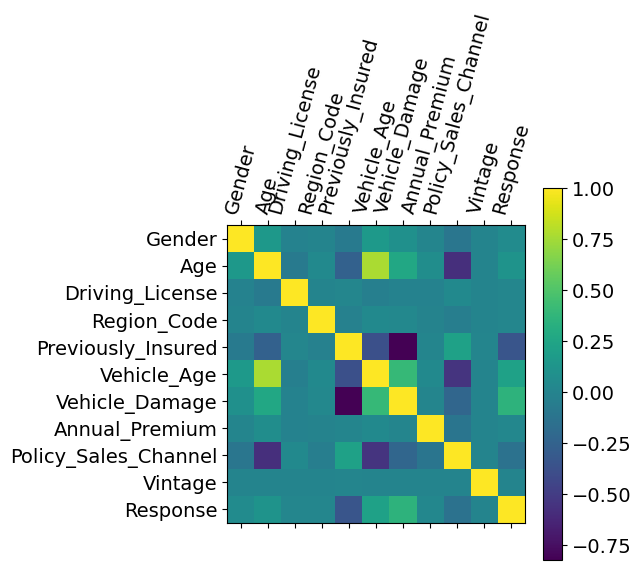

In [30]:
# Plot correlation matrix
f = plt.figure(figsize=(13, 11))
# Remove fignum argument
plt.matshow(corr_matrix)
plt.xticks(range(train_numeric.shape[1]), train_numeric.columns, fontsize=14, rotation=75)
plt.yticks(range(train_numeric.shape[1]), train_numeric.columns, fontsize=14)
cb = plt.colorbar()
cb.ax.tick_params(labelsize=14)
plt.show()

In [31]:
# Correlation for every feature with target
for col in train.columns:
    if col != 'Response':
        print(f"{col}: {round(train[col].corr(train['Response']), 4)}")

Gender: 0.0524
Age: 0.1111
Driving_License: 0.0102
Region_Code: 0.0106
Previously_Insured: -0.3412
Vehicle_Age: 0.2219
Vehicle_Damage: 0.3544
Annual_Premium: 0.0226
Policy_Sales_Channel: -0.139
Vintage: -0.0011


In [32]:

# Scatter plot for Annual Premium vs Age colored by Response
fig = px.scatter(train,
                 x="Annual_Premium",
                 y="Age",
                 color="Response",
                 width=600,
                 height=600,
                 title='Annual Premium vs Age Scatter Plot')

fig.show()

<a id="3"></a>
<h2 style='background:blue; border:0; color:white'><center>3. Modeling</center><h2>

In [33]:
# Data Preparation
X = train.drop(['Response'], axis=1)
y = train['Response']

In [34]:
# KMeans Clustering
kmeans = KMeans(n_clusters=2, random_state=666).fit(X)
train['cluster'] = kmeans.labels_
print('KMeans Accuracy:', accuracy_score(train['Response'], train['cluster']))
print('KMeans F1 Score:', f1_score(train['Response'], train['cluster']))

KMeans Accuracy: 0.7363326502391704
KMeans F1 Score: 0.15293185419968305


In [35]:
# COPOD Anomaly Detection
response = train['Response']
train = train.drop(['Response', 'cluster'], axis=1)
clf = COPOD(contamination=0.15)
clf.fit(train)
train['cluster'] = clf.predict(train)
train['Response'] = response
print('COPOD Accuracy:', accuracy_score(train['Response'], train['cluster']))
print('COPOD F1 Score:', f1_score(train['Response'], train['cluster']))

COPOD Accuracy: 0.7634246370460944
COPOD F1 Score: 0.1320407789982383


In [36]:
# Train-Test Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=666)
print('Positive cases in validation set:', round(100 * len(y_test[y_test == 1]) / len(y_test), 3), '%')
print('Positive cases in train set:', round(100 * len(y_train[y_train == 1]) / len(y_train), 3), '%')


Positive cases in validation set: 12.343 %
Positive cases in train set: 12.235 %


In [37]:
# Logistic Regression
model = LogisticRegression(random_state=666)
model.fit(X_train, y_train)
preds = model.predict(X_test)
print('Logistic Regression Accuracy:', accuracy_score(y_test, preds))
print('Logistic Regression F1 Score:', f1_score(y_test, preds))

Logistic Regression Accuracy: 0.8724515231822834
Logistic Regression F1 Score: 0.09680416202155333


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



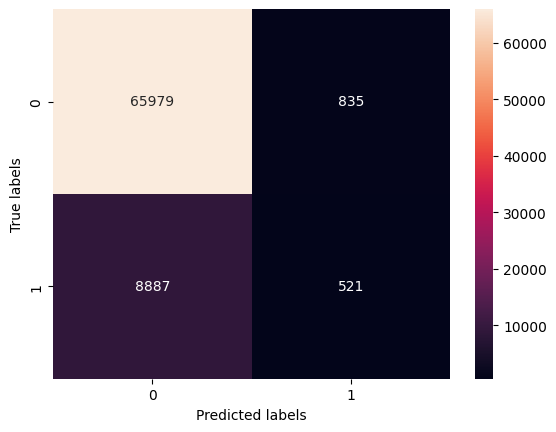

In [38]:
# Confusion Matrix Plotting
def plot_confusion_matrix(y_real, y_pred):
    cm = confusion_matrix(y_real, y_pred)
    ax = plt.subplot()
    sns.heatmap(cm, annot=True, fmt='g', ax=ax)
    ax.set_xlabel('Predicted labels')
    ax.set_ylabel('True labels')
    plt.show()

plot_confusion_matrix(y_test, preds)

In [39]:
# Feature Selection
X_train = X_train.drop(['Region_Code', 'Vintage', 'Driving_License'], axis=1)
X_test = X_test.drop(['Region_Code', 'Vintage', 'Driving_License'], axis=1)

In [40]:
# LightGBM Model
model = LGBMClassifier(random_state=666)
model.fit(X_train, y_train)
preds = model.predict(X_test)
print('LGBM Accuracy:', accuracy_score(y_test, preds))
print('LGBM F1 Score:', f1_score(y_test, preds))


[LightGBM] [Info] Number of positive: 37302, number of negative: 267585
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.036723 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 462
[LightGBM] [Info] Number of data points in the train set: 304887, number of used features: 7
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.122347 -> initscore=-1.970390
[LightGBM] [Info] Start training from score -1.970390
LGBM Accuracy: 0.8763349164283277
LGBM F1 Score: 0.006325110689437065


In [41]:
# XGBoost Hyperparameter Tuning
def create_model(trial):
    return XGBClassifier(
        max_depth=trial.suggest_int("max_depth", 2, 20),
        n_estimators=trial.suggest_int("n_estimators", 1, 400),
        learning_rate=trial.suggest_uniform('learning_rate', 0.0000001, 1),
        gamma=trial.suggest_uniform('gamma', 0.0000001, 1),
        scale_pos_weight=trial.suggest_int("scale_pos_weight", 1, 20),
        random_state=0
    )

def objective(trial):
    model = create_model(trial)
    model.fit(X_train, y_train)
    return f1_score(y_test, model.predict(X_test))

In [42]:
sampler = TPESampler(seed=0)
study = optuna.create_study(direction="maximize", sampler=sampler)
study.optimize(objective, n_trials=500)
xgb_params = study.best_params
xgb = XGBClassifier(**xgb_params, random_state=0)
xgb.fit(X_train, y_train)
preds = xgb.predict(X_test)


[I 2025-03-16 04:12:50,136] A new study created in memory with name: no-name-914dee2e-b0e3-48b8-a86e-20f929fb0644
<ipython-input-41-03ae5c07d9a7>:6: FutureWarning:

suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.

<ipython-input-41-03ae5c07d9a7>:7: FutureWarning:

suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float instead.

[I 2025-03-16 04:13:05,115] Trial 0 finished with value: 0.42641875670429585 and parameters: {'max_depth': 12, 'n_estimators': 287, 'learning_rate': 0.6027634157953062, 'gamma': 0.5448832285085785, 'scale_pos_weight': 9}. Best is trial 0 with value: 0.42641875670429585.
<ipython-input-41-03ae5c07d9a7>:6: FutureWarning:

suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna

Optimized XGBClassifier Accuracy: 0.7639001862979192
Optimized XGBClassifier F1 Score: 0.4592548076923077


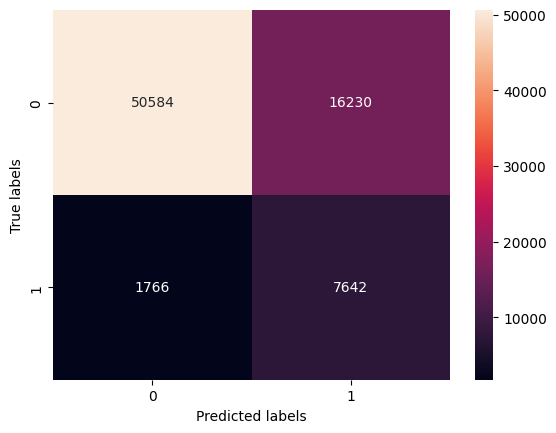

In [43]:
print('Optimized XGBClassifier Accuracy:', accuracy_score(y_test, preds))
print('Optimized XGBClassifier F1 Score:', f1_score(y_test, preds))
plot_confusion_matrix(y_test, preds)

In [44]:
# RandomForest Hyperparameter Tuning
def create_rf_model(trial):
    return RandomForestClassifier(
        min_samples_leaf=trial.suggest_int("min_samples_leaf", 1, 10),
        n_estimators=trial.suggest_int("n_estimators", 2, 200),
        max_depth=trial.suggest_int("max_depth", 2, 7),
        random_state=0
    )

def rf_objective(trial):
    model = create_rf_model(trial)
    model.fit(X_train, y_train)
    return f1_score(y_test, model.predict(X_test))

In [45]:
study = optuna.create_study(direction="maximize", sampler=sampler)
study.optimize(rf_objective, n_trials=100)
rf_params = study.best_params
rf = RandomForestClassifier(**rf_params)
rf.fit(X_train, y_train)
preds = rf.predict(X_test)


[I 2025-03-16 04:37:00,868] A new study created in memory with name: no-name-97e0fdb4-1090-4f0b-9e51-4ad1c7e2f05b
[I 2025-03-16 04:37:19,264] Trial 0 finished with value: 0.0 and parameters: {'min_samples_leaf': 6, 'n_estimators': 89, 'max_depth': 7}. Best is trial 0 with value: 0.0.
[I 2025-03-16 04:37:22,499] Trial 1 finished with value: 0.0 and parameters: {'min_samples_leaf': 2, 'n_estimators': 43, 'max_depth': 2}. Best is trial 0 with value: 0.0.
[I 2025-03-16 04:37:29,231] Trial 2 finished with value: 0.0 and parameters: {'min_samples_leaf': 7, 'n_estimators': 52, 'max_depth': 4}. Best is trial 0 with value: 0.0.
[I 2025-03-16 04:37:32,124] Trial 3 finished with value: 0.0 and parameters: {'min_samples_leaf': 3, 'n_estimators': 33, 'max_depth': 2}. Best is trial 0 with value: 0.0.
[I 2025-03-16 04:37:34,921] Trial 4 finished with value: 0.0 and parameters: {'min_samples_leaf': 7, 'n_estimators': 29, 'max_depth': 3}. Best is trial 0 with value: 0.0.
[I 2025-03-16 04:37:49,254] Tri

Optimized RF Accuracy: 0.876571068720317
Optimized RF F1 Score: 0.0


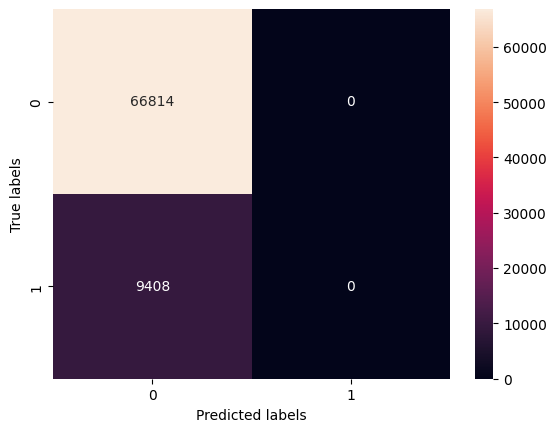

In [46]:
print('Optimized RF Accuracy:', accuracy_score(y_test, preds))
print('Optimized RF F1 Score:', f1_score(y_test, preds))
plot_confusion_matrix(y_test, preds)

In [55]:
import tensorflow.keras.backend as K

In [56]:
def recall_score(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    return true_positives / (possible_positives + K.epsilon())

def precision_score(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
    return true_positives / (predicted_positives + K.epsilon())

def keras_f1_score(y_true, y_pred):
    precision = precision_score(y_true, y_pred)
    recall = recall_score(y_true, y_pred)
    return 2 * ((precision * recall) / (precision + recall + K.epsilon()))

def create_nn_model():
    model = tf.keras.Sequential([
        tf.keras.layers.Input(shape=(7,)),  # Fix applied here
        tf.keras.layers.BatchNormalization(),
        tf.keras.layers.Dense(30, activation="relu"),
        tf.keras.layers.BatchNormalization(),
        tf.keras.layers.Dropout(0.3),
        tf.keras.layers.Dense(2, activation='softmax')
    ])

    model.compile(loss=tf.keras.losses.binary_crossentropy,
                  optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
                  metrics=[keras_f1_score])

    return model

In [57]:
y_nn_train = to_categorical(y_train)
class_weight = {0: 1., 1: 8.}
model = create_nn_model()
model.fit(X_train, y_nn_train, validation_split=0.2, epochs=35, batch_size=256, verbose=2, class_weight=class_weight)
preds = np.argmax(model.predict(X_test), axis=1)



Epoch 1/35
953/953 - 7s - 8ms/step - keras_f1_score: 0.6489 - loss: 0.9170 - val_keras_f1_score: 0.6524 - val_loss: 0.5231
Epoch 2/35
953/953 - 4s - 4ms/step - keras_f1_score: 0.6733 - loss: 0.8150 - val_keras_f1_score: 0.6545 - val_loss: 0.5224
Epoch 3/35
953/953 - 5s - 5ms/step - keras_f1_score: 0.6762 - loss: 0.8075 - val_keras_f1_score: 0.6648 - val_loss: 0.5230
Epoch 4/35
953/953 - 3s - 3ms/step - keras_f1_score: 0.6774 - loss: 0.8042 - val_keras_f1_score: 0.6775 - val_loss: 0.5068
Epoch 5/35
953/953 - 5s - 5ms/step - keras_f1_score: 0.6763 - loss: 0.8024 - val_keras_f1_score: 0.6868 - val_loss: 0.4937
Epoch 6/35
953/953 - 4s - 4ms/step - keras_f1_score: 0.6752 - loss: 0.8025 - val_keras_f1_score: 0.6830 - val_loss: 0.5071
Epoch 7/35
953/953 - 3s - 4ms/step - keras_f1_score: 0.6761 - loss: 0.8003 - val_keras_f1_score: 0.6852 - val_loss: 0.4912
Epoch 8/35
953/953 - 6s - 7ms/step - keras_f1_score: 0.6768 - loss: 0.7997 - val_keras_f1_score: 0.6757 - val_loss: 0.4910
Epoch 9/35
953/9

NN Accuracy: 0.6758022618141744
NN F1 Score: 0.4197252553716097


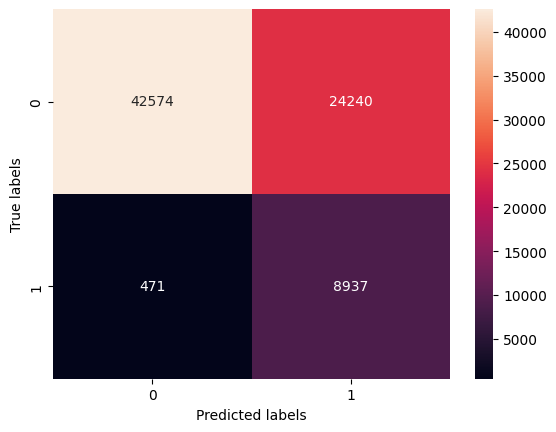

In [58]:
print('NN Accuracy:', accuracy_score(y_test, preds))
print('NN F1 Score:', f1_score(y_test, preds))
plot_confusion_matrix(y_test, preds)